In [3]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import missingno
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline


# New Section

In statistics, exploratory data analysis (EDA) is an approach to analyzing data sets to summarize their main characteristics, often with visual methods. A statistical model can be used or not, but primarily EDA is for seeing what the data can tell us beyond the formal modeling or hypothesis testing task.

EDA “is an approach to analyzing datasets to summarize their main characteristics, often with visual methods”. 

In my own words, it is about knowing your data, gaining a certain amount of familiarity with the data, before one starts to extract insights from it.


To gain an understanding of data and find clues from the data,
to formulate assumptions and hypothesis for our modelling; and
to check the quality of data for further processing and cleaning if necessary.
To check for features that can help in forecasting sales; and
To check for anomalies or outliers that may impact our forecasting model.

General Outline of EDA
Our code template shall perform the following steps:
Preview data
Check total number of entries and column types
Check any null values
Check duplicate entries
Plot distribution of numeric data (univariate and pairwise joint distribution)
Plot count distribution of categorical data
Analyze time series of numeric data by daily, monthly and yearly frequencies



**Preliminary Data Processing**

In [4]:
df = pd.read_csv('train.csv')
df.info()
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


 In a nutshell, there are three common types of data type (categorical, numeric and datetime) and we have different EDA procedures for each of them.

In [5]:
# set identifier "Id and MiscFeatures" as strings
df['Id'] = df['Id'].astype('str')
df['MiscFeature'] = df['MiscFeature'].astype('str')
# set categorical data
df['MSSubClass'] = df['MSSubClass'].astype('category')
df['MSZoning'] = df['MSZoning'].astype('category')
df['Street'] = df['Street'].astype('category')
df['Alley'] = df['Alley'].astype('category')
df['LotShape'] = df['LotShape'].astype('category')
df['LandContour'] = df['LandContour'].astype('category')
df['Utilities'] = df['Utilities'].astype('category')
df['LotConfig'] = df['LotConfig'].astype('category')
df['LandSlope'] = df['LandSlope'].astype('category')
df['Neighborhood'] = df['Neighborhood'].astype('category')
df['Condition1'] = df['Condition1'].astype('category')
df['Condition2'] = df['Condition2'].astype('category')
df['BldgType'] = df['BldgType'].astype('category')
df['HouseStyle'] = df['HouseStyle'].astype('category')
df['RoofStyle'] = df['RoofStyle'].astype('category')
df['RoofMatl'] = df['RoofMatl'].astype('category')
df['Exterior1st'] = df['Exterior1st'].astype('category')
df['Exterior2nd'] = df['Exterior2nd'].astype('category')
df['MasVnrType'] = df['MasVnrType'].astype('category')
df['ExterQual'] = df['ExterQual'].astype('category')
df['ExterCond'] = df['ExterCond'].astype('category')
df['Foundation'] = df['Foundation'].astype('category')
df['BsmtQual'] = df['BsmtQual'].astype('category')
df['BsmtCond'] = df['BsmtCond'].astype('category')
df['BsmtExposure'] = df['BsmtExposure'].astype('category')
df['BsmtFinType1'] = df['BsmtFinType1'].astype('category')
df['BsmtFinType2'] = df['BsmtFinType2'].astype('category')
df['Heating'] = df['Heating'].astype('category')
df['HeatingQC'] = df['HeatingQC'].astype('category')
df['CentralAir'] = df['CentralAir'].astype('category')
df['Electrical'] = df['Electrical'].astype('category')
df['KitchenQual'] = df['KitchenQual'].astype('category')
df['Functional'] = df['Functional'].astype('category')
df['FireplaceQu'] = df['FireplaceQu'].astype('category')
df['GarageType'] = df['GarageType'].astype('category')
df['GarageFinish'] = df['GarageFinish'].astype('category')
df['GarageQual'] = df['GarageQual'].astype('category')
df['GarageCond'] = df['GarageCond'].astype('category')
df['PavedDrive'] = df['PavedDrive'].astype('category')
df['PoolQC'] = df['PoolQC'].astype('category')
df['Fence'] = df['Fence'].astype('category')
df['SaleType'] = df['SaleType'].astype('category')
df['SaleCondition'] = df['SaleCondition'].astype('category')
# set datetime data
df['YearBuilt'] = pd.to_datetime(df['YearBuilt'])
df['YearRemodAdd'] = pd.to_datetime(df['YearRemodAdd'])
df['GarageYrBlt'] = pd.to_datetime(df['GarageYrBlt'])
df['MoSold'] = pd.to_datetime(df['MoSold'])
df['YrSold'] = pd.to_datetime(df['YrSold'])

                    



In [6]:
def numeric_eda(df, hue=None):
    """Given dataframe, generate EDA of numeric data"""
    print("\nTo check: \nDistribution of numeric data")
    display(df.describe().T)
    columns = df.select_dtypes(include=np.number).columns
    figure = plt.figure(figsize=(20, 10))
    figure.add_subplot(1, len(columns), 1)
    for index, col in enumerate(columns):
        if index > 0:
            figure.add_subplot(1, len(columns), index + 1)
        sns.boxplot(y=col, data=df, boxprops={'facecolor': 'None'})
    figure.tight_layout()
    plt.show()
    
    if len(df.select_dtypes(include='category').columns) > 0:
        for col_num in df.select_dtypes(include=np.number).columns:
            for col in df.select_dtypes(include='category').columns:
                fig = sns.catplot(x=col, y=col_num, kind='violin', data=df, height=5, aspect=2)
                fig.set_xticklabels(rotation=90)
                plt.show()
    
    # Plot the pairwise joint distributions
    print("\nTo check pairwise joint distribution of numeric data")
    if hue==None:
        sns.pairplot(df.select_dtypes(include=np.number))
    else:
        sns.pairplot(df.select_dtypes(include=np.number).join(df[[hue]]), hue=hue)
    plt.show()



    
    

    



In [8]:
def top5(df):
    """Given dataframe, generate top 5 unique values for non-numeric data"""
    columns = df.select_dtypes(include=['object', 'category']).columns
    for col in columns:
        print("Top 5 unique values of " + col)
        print(df[col].value_counts().reset_index().rename(columns={"index": col, col: "Count"})[
              :min(5, len(df[col].value_counts()))])
        print(" ")

In [10]:
def eda(df):
    """Given dataframe, generate exploratory data analysis"""
    # check that input is pandas dataframe
    if type(df) != pd.core.frame.DataFrame:
        raise TypeError("Only pandas dataframe is allowed as input")
        
    # replace field that's entirely space (or empty) with NaN
    df = df.replace(r'^\s*$', np.nan, regex=True)

    print("Preview of data:")
    display(df.head(3))

    print("\nTo check: \n (1) Total number of entries \n (2) Column types \n (3) Any null values\n")
    print(df.info())

    # generate preview of entries with null values
    if len(df[df.isnull().any(axis=1)] != 0):
        print("\nPreview of data with null values:")
        display(df[df.isnull().any(axis=1)].head(3))
        missingno.matrix(df)
        plt.show()

    # generate count statistics of duplicate entries
    if len(df[df.duplicated()]) > 0:
        print("\n***Number of duplicated entries: ", len(df[df.duplicated()]))
        display(df[df.duplicated(keep=False)].sort_values(by=list(df.columns)).head())
    else:
        print("\nNo duplicated entries found")



# Categorical Data EDA


To check: Unique count of non-numeric data
MSSubClass       15
MSZoning          5
Street            2
Alley             2
LotShape          4
LandContour       4
Utilities         2
LotConfig         5
LandSlope         3
Neighborhood     25
Condition1        9
Condition2        8
BldgType          5
HouseStyle        8
RoofStyle         6
RoofMatl          8
Exterior1st      15
Exterior2nd      16
MasVnrType        4
ExterQual         4
ExterCond         5
Foundation        6
BsmtQual          4
BsmtCond          4
BsmtExposure      4
BsmtFinType1      6
BsmtFinType2      6
Heating           6
HeatingQC         5
CentralAir        2
Electrical        5
KitchenQual       4
Functional        7
FireplaceQu       5
GarageType        6
GarageFinish      3
GarageQual        5
GarageCond        5
PavedDrive        3
PoolQC            3
Fence             4
SaleType          9
SaleCondition     6
dtype: int64
Top 5 unique values of Id
     Id  Count
0   520      1
1   124      1
2  1106      

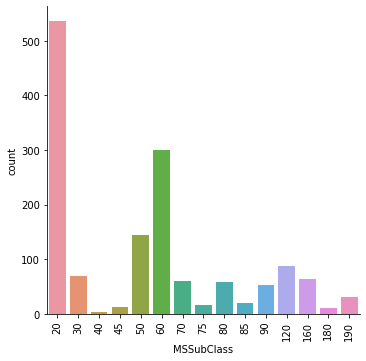

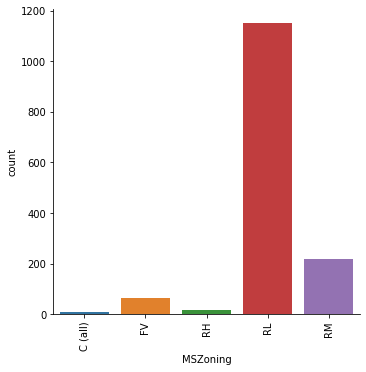

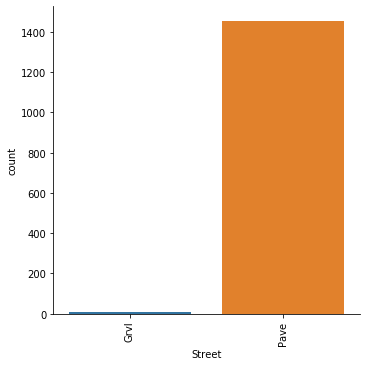

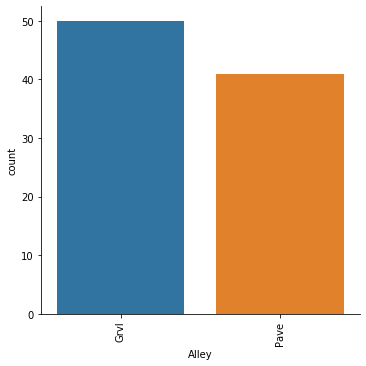

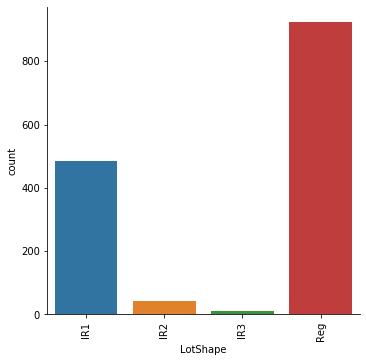

...

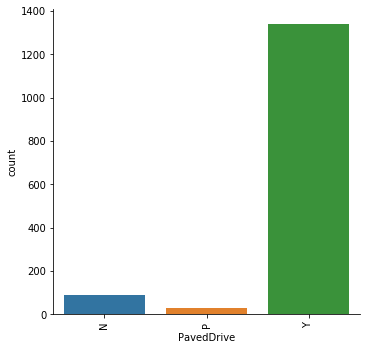

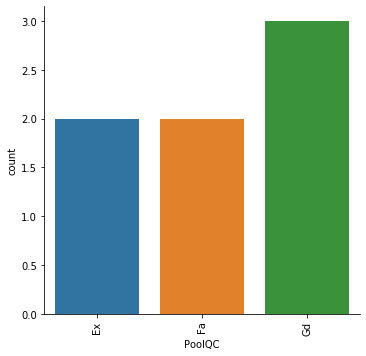

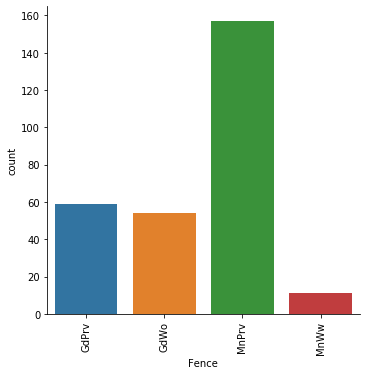

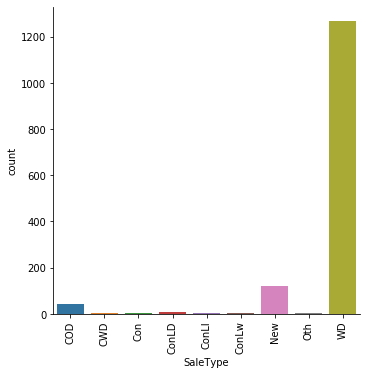

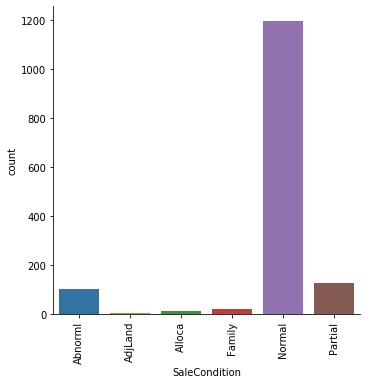

In [16]:
def categorical_eda(df):
    """Given dataframe, generate EDA of categorical data"""
    print("To check: Unique count of non-numeric data")
    print(df.select_dtypes(include=['category']).nunique())
    top5(df)
    # Plot count distribution of categorical data
    for col in df.select_dtypes(include='category').columns:
        fig = sns.catplot(x=col, kind="count", data=df)
        fig.set_xticklabels(rotation=90)
        plt.show()

categorical_eda(df)

Our main EDA objective for categorical data is to know the unique values and their corresponding count.

# Numeric Data EDA

For numeric data, our EDA approach is as follows:

1. Plot univariate distribution of each numeric data
2. If categorical data are available, plot univariate distribution by each categorical value
3. Plot pairwise joint distribution of numeric data


To check: 
Distribution of numeric data


,count,mean,std,min,25%,50%,75%,max
LotFrontage,1201.0,70.049958,24.284752,21.0,59.00,69.0,80.00,313.0
LotArea,1460.0,10516.828082,9981.264932,1300.0,7553.50,9478.5,11601.50,215245.0
OverallQual,1460.0,6.099315,1.382997,1.0,5.00,6.0,7.00,10.0
OverallCond,1460.0,5.575342,1.112799,1.0,5.00,5.0,6.00,9.0
MasVnrArea,1452.0,103.685262,181.066207,0.0,0.00,0.0,166.00,1600.0
BsmtFinSF1,1460.0,443.639726,456.098091,0.0,0.00,383.5,712.25,5644.0
BsmtFinSF2,1460.0,46.549315,161.319273,0.0,0.00,0.0,0.00,1474.0
BsmtUnfSF,1460.0,567.240411,441.866955,0.0,223.00,477.5,808.00,2336.0
TotalBsmtSF,1460.0,1057.429452,438.705324,0.0,795.75,991.5,1298.25,6110.0
1stFlrSF,1460.0,1162.626712,386.587738,334.0,882.00,1087.0,1391.25,4692.0


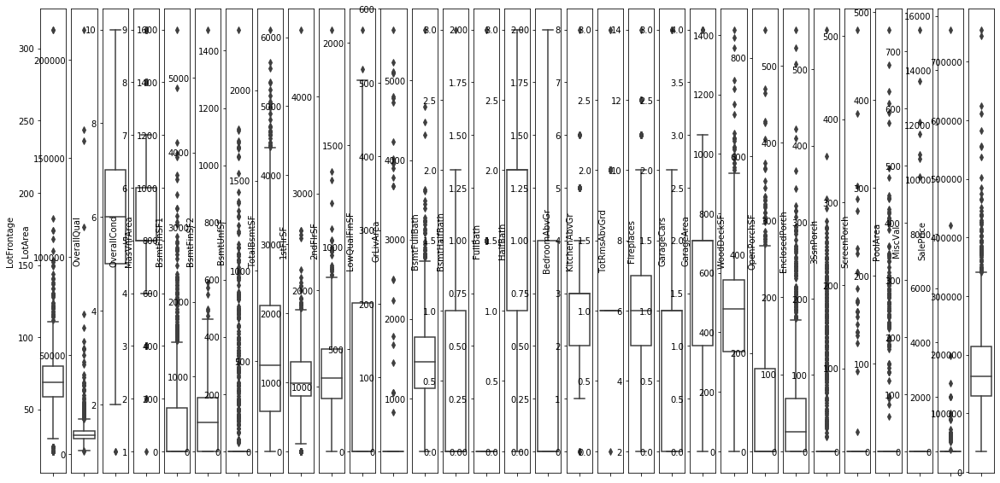

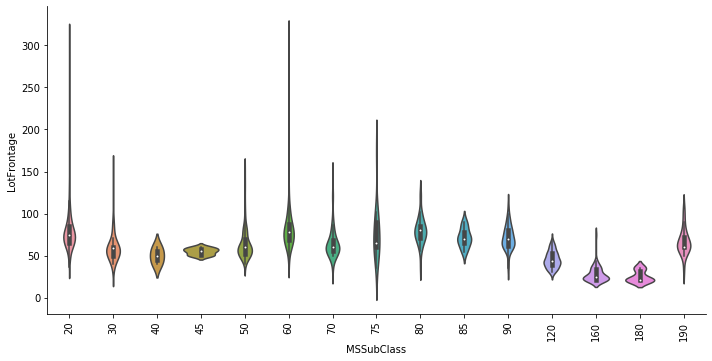

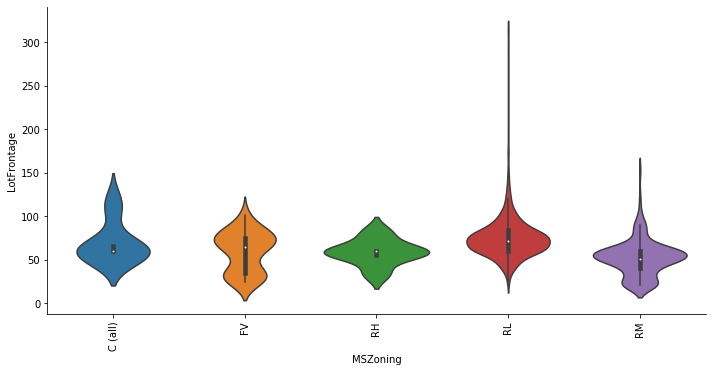

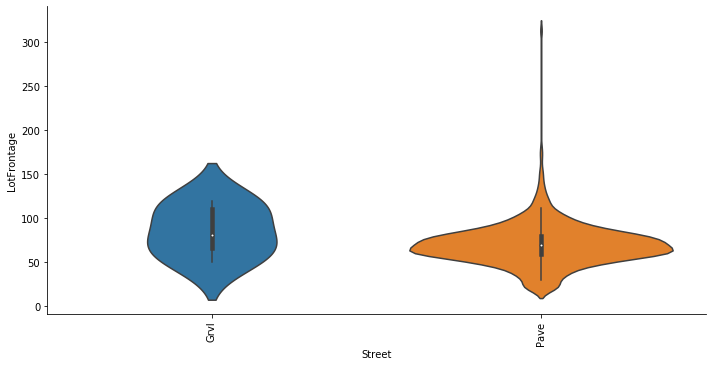

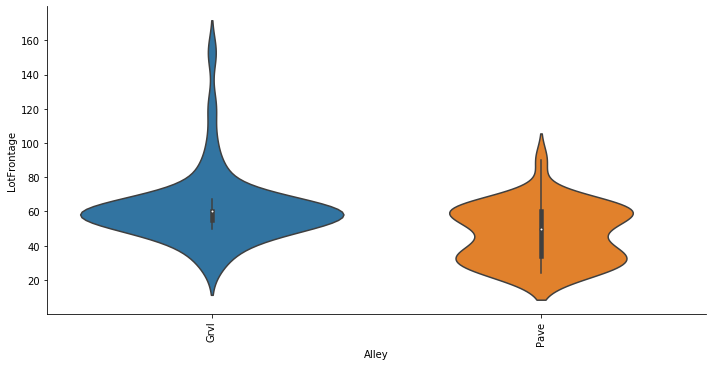

...

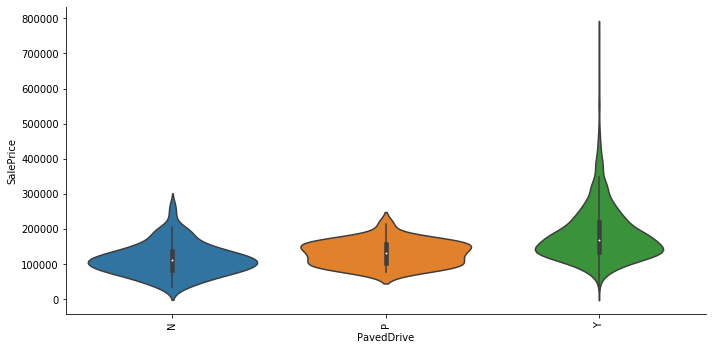

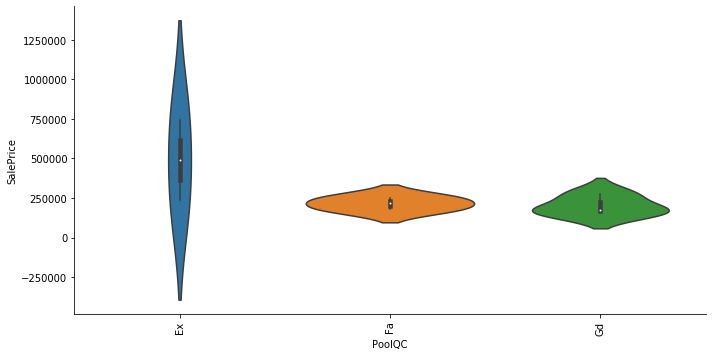

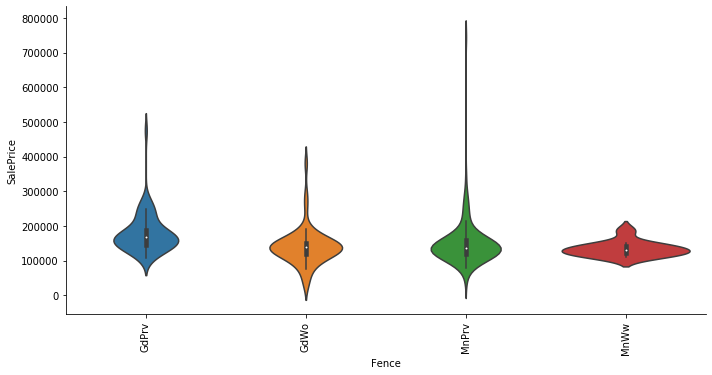

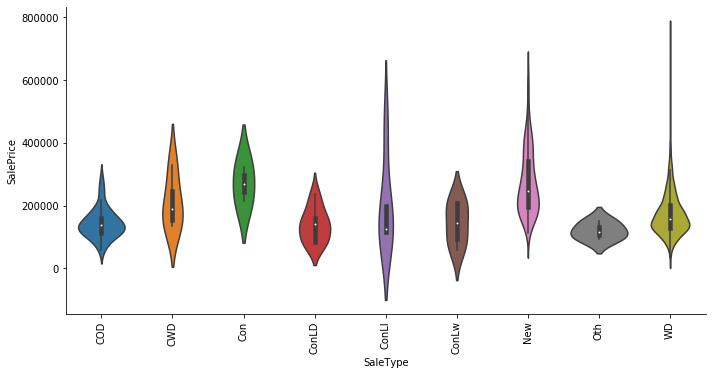

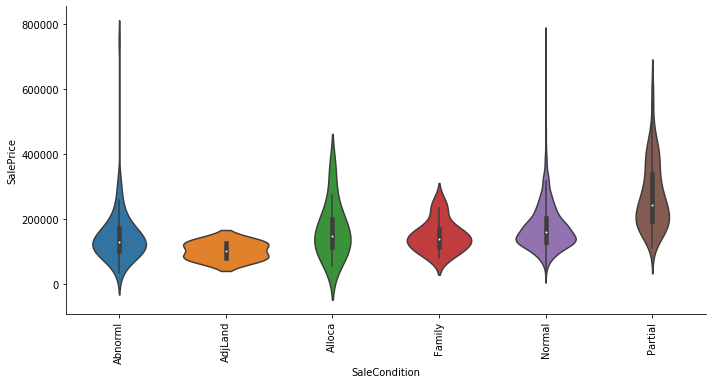


To check pairwise joint distribution of numeric data


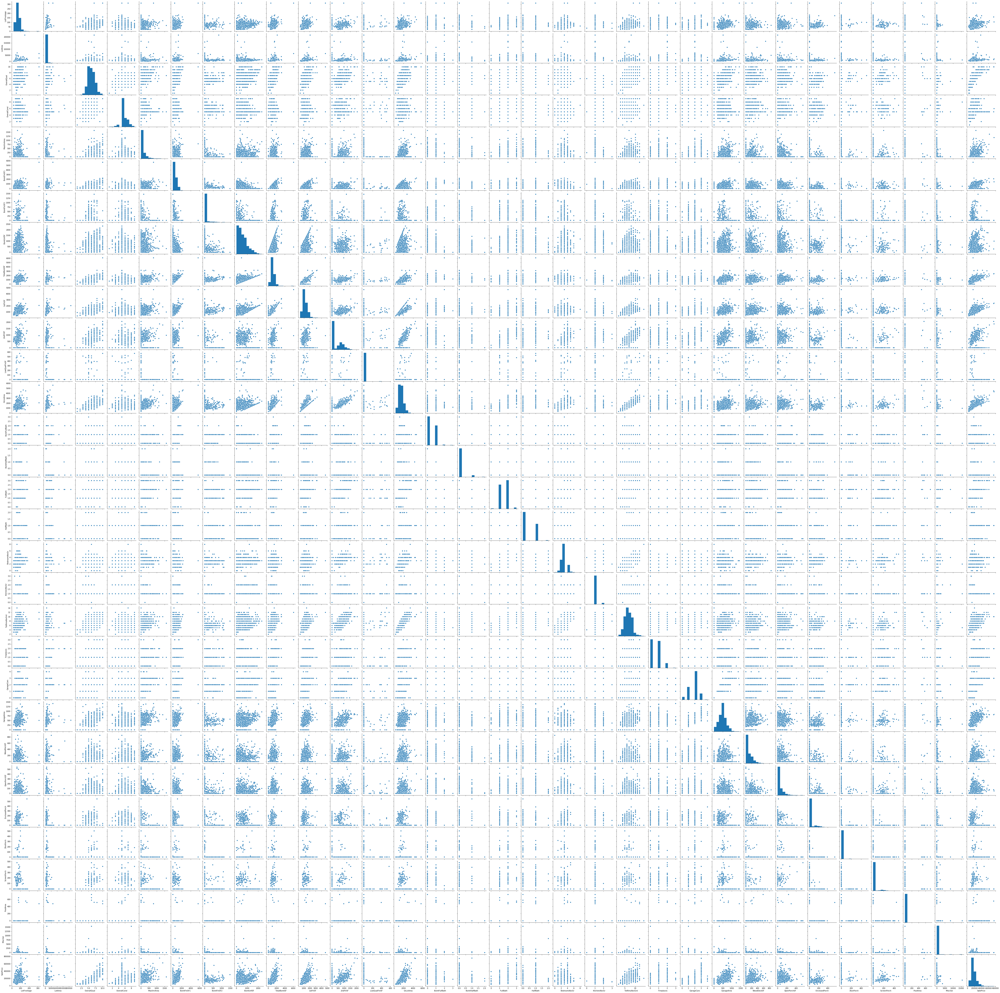

In [18]:
numeric_eda(df)
